In [3]:
import os, sys, glob, shutil
import argparse
import json
import yaml
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm.notebook import tqdm
from pprint import pprint
import torchaudio
import torch
from IPython.display import Audio, display

In [4]:
%cd "D:\Schoolwork\TERM 3\WORK\visual_prosody"

D:\Schoolwork\TERM 3\WORK\visual_prosody


In [5]:
val_mcdv6_df = pd.read_csv(r".\jupyter_walkthrough\metrics\MCD_0703a_1M4.csv")
train_mcdv6_df = pd.read_csv(r".\jupyter_walkthrough\metrics\MCD_0703a_1M4_train.csv")

In [6]:
val_mcdv6_df.nsmallest(5, 'MCD_recon')

,Unnamed: 0,uid,MCD_recon,MCD_gt
29,29,0fc4a693-2ba5-419b-83cc-51d5e70b75b9,5.854140,7.754389
562,562,dcd3a1bc-beb5-49ac-a2c0-833ff646620f,6.501545,14.302723
1557,1557,7f53c386-bf80-47bd-8dbe-295b21eeb289,6.755201,8.376004
109,109,3247ffa3-adc8-4978-9be8-4b07a0995e7b,7.198319,8.091181
580,580,b8adbe87-2c00-411b-8e12-d769fb3ee849,7.651339,9.147169


<Axes: ylabel='Frequency'>

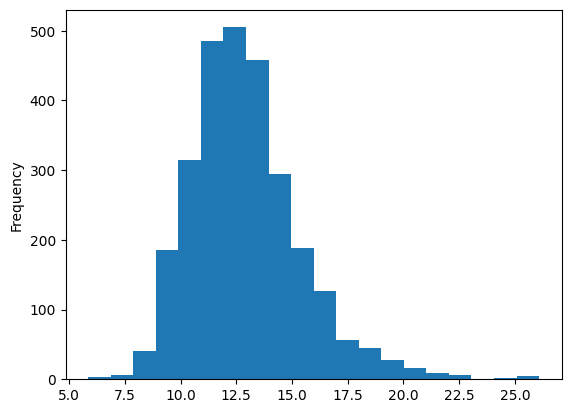

In [7]:
val_mcdv6_df['MCD_recon'].plot(kind='hist', bins=20)

<Axes: ylabel='Frequency'>

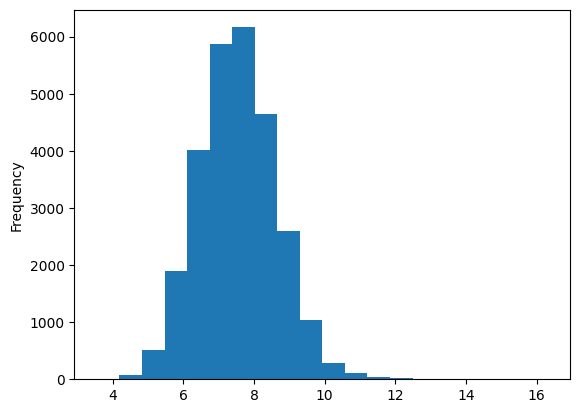

In [8]:
train_mcdv6_df['MCD_recon'].plot(kind='hist', bins=20)

In [7]:
val_mcdv6_df['MCD_recon'].describe()

count    2772.000000
mean       12.921547
std         2.466970
min         5.854140
25%        11.248916
50%        12.606448
75%        14.192489
max        26.086525
Name: MCD_recon, dtype: float64

In [8]:
train_mcdv6_df['MCD_recon'].describe()

count    27292.000000
mean         7.545383
std          1.107644
min          3.558908
25%          6.787040
50%          7.513287
75%          8.256839
max         16.314287
Name: MCD_recon, dtype: float64

In [9]:
val_mcdv6_df['MCD_recon'].quantile(0.9)

16.0744124

In [10]:
val_mcdv6_df[val_mcdv6_df['MCD_recon']<val_mcdv6_df['MCD_recon'].quantile(0.95)]['MCD_recon'].describe()

count    2633.000000
mean       12.579408
std         1.972606
min         5.854140
25%        11.154775
50%        12.464055
75%        13.891934
max        17.394718
Name: MCD_recon, dtype: float64

In [10]:
val_mcdv6_df[val_mcdv6_df['MCD_recon']<16]['MCD_recon'].describe()

count    2483.000000
mean       12.338174
std         1.759287
min         5.854140
25%        11.064789
50%        12.333565
75%        13.626205
max        15.988463
Name: MCD_recon, dtype: float64

In [12]:
target = 11
val_mcdv6_df.iloc[(val_mcdv6_df['MCD_recon']-target).abs().argsort()[:1]]

,Unnamed: 0,uid,MCD_recon,MCD_gt
1809,1809,93fd51b0-4a0a-4c6e-bf7e-8d94295f5f6a,10.999154,12.054925


In [14]:
def get_topk_closet(target, k, df, col='MCD_recon'):
    return df.iloc[(df[col]-target).abs().argsort()[:k]]

In [15]:
get_topk_closet(18, 2, df=val_mcdv6_df)

,Unnamed: 0,uid,MCD_recon,MCD_gt
2462,2462,6789cd7c-fa96-4a3e-8c65-1247c1babd0f,18.000761,11.359415
229,229,e72f34b7-2b94-418a-9903-b824166e2017,17.998682,16.455362


In [16]:
selection = get_topk_closet(18, 2, df=val_mcdv6_df)
for uid in selection['uid'].values:
    print(uid)

6789cd7c-fa96-4a3e-8c65-1247c1babd0f
e72f34b7-2b94-418a-9903-b824166e2017


In [89]:
def display_audio(uid, split):
    sampled_uid = uid
    # print(f"uid: {sampled_uid}")
    
    if split == 'train':
        wav_path = os.path.join(r".\output\0703a\result\Ego4D_final_v6\train\wav\synthesized", f"{sampled_uid}.wav")
        mel_path = os.path.join(r".\output\0703a\result\Ego4D_final_v6\train\mel\syn", f"{sampled_uid}.pt")
    elif split == 'val':
        wav_path = os.path.join(r".\output\0703a\result\Ego4D_final_v6\wav\synthesized", f"{sampled_uid}.wav")
        mel_path = os.path.join(r".\output\0703a\result\Ego4D_final_v6\mel\syn", f"{sampled_uid}.pt")

    display(Audio(filename=wav_path, rate=22050))
    mel_np = torch.load(mel_path).numpy()
    print(mel_np.shape)
    nparray_mel_to_svg(mel_np, "/content/test_v6.svg")

def display_gt_audio(uid, split):
    sampled_uid = uid
    # print(f"uid: {sampled_uid}")
    if split == 'train':
        wav_path = os.path.join(r".\raw_data\Ego4D_final_v6\train\Ego4D_final_v6", f"{sampled_uid}.wav")
    elif split == 'val':
        wav_path = os.path.join(r".\raw_data\Ego4D_final_v6\val\Ego4D_final_v6", f"{sampled_uid}.wav")
    display(Audio(filename=wav_path, rate=22050))

def display_gt_audio_v56(uid, split):
    sampled_uid = uid
    # print(f"uid: {sampled_uid}")
    if split == 'train':
        wav_path = os.path.join(r".\raw_data\Ego4D_final_v6\train\Ego4D_final_v6", f"{sampled_uid}.wav")
        wav_path_v5 = os.path.join(r".\raw_data\Ego4D_final_v5\train\Ego4D_final_v5", f"{sampled_uid}.wav")
    elif split == 'val':
        wav_path = os.path.join(r".\raw_data\Ego4D_final_v6\val\Ego4D_final_v6", f"{sampled_uid}.wav")
        wav_path_v5 = os.path.join(r".\raw_data\Ego4D_final_v5\val\Ego4D_final_v5", f"{sampled_uid}.wav")
    display(Audio(filename=wav_path, rate=22050))
    try:
        display(Audio(filename=wav_path_v5, rate=22050))
    except:
        print('v5 not exist')

def nparray_mel_to_svg(mel_array, svg_path):
    vmin = -12.5
    vmax = 0.0
    spec = mel_array
    fig = plt.figure(figsize=(5,2), tight_layout=True) #(20,4)
    ax = fig.add_subplot()
    image = ax.imshow(spec, cmap="jet", origin="lower",
                aspect="equal", interpolation="none", vmax=vmax, vmin=vmin)
    fig.colorbar(mappable=image, orientation='vertical', ax=ax, shrink=0.5)

    # plt.savefig(svg_path, format="svg", bbox_inches='tight')
    plt.plot()


(80, 27)


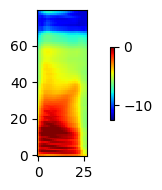

In [71]:
display_audio(uid='6789cd7c-fa96-4a3e-8c65-1247c1babd0f', split='val')

In [72]:
def display_topk_closet(target, k, split, df):
    print(f"Top {k} utt with MCD closet to {target}. [{split} set]\n")
    selection = get_topk_closet(target, k, df=df)
    for uid, mcd in zip(selection['uid'].values, selection['MCD_recon'].values):
        print(f"UID: {uid}")
        print(f"###  MCD: {mcd}")
        display_audio(uid=uid, split=split)

In [90]:
def display_topk_closet_gt(target, k, split, df):
    print(f"Top {k} utt with MCD closet to {target}. [{split} set]\n")
    selection = get_topk_closet(target, k, df=df)
    for uid, mcd in zip(selection['uid'].values, selection['MCD_recon'].values):
        print(f"UID: {uid}")
        print(f"###  MCD: {mcd}")
        display_gt_audio(uid=uid, split=split)

def display_topk_closet_gt_v56(target, k, split, df):
    print(f"Top {k} utt with MCD closet to {target}. [{split} set]\n")
    selection = get_topk_closet(target, k, df=df)
    for uid, mcd in zip(selection['uid'].values, selection['MCD_recon'].values):
        print(f"UID: {uid}")
        print(f"###  MCD: {mcd}")
        display_gt_audio_v56(uid=uid, split=split)

Top 20 utt with MCD closet to 0. [val set]

UID: 0fc4a693-2ba5-419b-83cc-51d5e70b75b9
###  MCD: 5.8541403


(80, 216)
UID: dcd3a1bc-beb5-49ac-a2c0-833ff646620f
###  MCD: 6.501545


(80, 24)
UID: 7f53c386-bf80-47bd-8dbe-295b21eeb289
###  MCD: 6.755201


(80, 66)
UID: 3247ffa3-adc8-4978-9be8-4b07a0995e7b
###  MCD: 7.1983185


(80, 24)
UID: b8adbe87-2c00-411b-8e12-d769fb3ee849
###  MCD: 7.6513386


(80, 28)
UID: 13912c1b-6def-4077-99b5-55016639a40b
###  MCD: 7.7250896


(80, 61)
UID: 4332a880-4c45-43dc-be03-bcee2159575b
###  MCD: 7.7614226


(80, 41)
UID: 102f7db2-1dde-489d-b4c4-b48feb8a204e
###  MCD: 7.791721


(80, 53)
UID: d9fdf898-9154-4817-96eb-fdf449b2ef5a
###  MCD: 7.8354173


(80, 67)
UID: ed7af408-b84a-4c02-82a4-85fcab3fc62a
###  MCD: 7.9037185


(80, 54)
UID: 373449b0-4444-4d62-9fdb-ec312bf2dbc2
###  MCD: 7.9544897


(80, 22)
UID: 96f7f706-db77-47ca-868e-fdc24d8dff7f
###  MCD: 7.9590006


(80, 103)
UID: b9cb960d-ab74-435f-bce7-f3c1851b6768
###  MCD: 8.01253


(80, 81)
UID: 1b1d0b00-68b8-4259-b569-cc9def32e63c
###  MCD: 8.046775


(80, 77)
UID: 310eca6d-46e0-4057-8f7c-d3087a7ba481
###  MCD: 8.075624


(80, 74)
UID: fc1e6a1b-9f47-44ea-af9e-f80c1d348147
###  MCD: 8.112765


(80, 75)
UID: ae03f670-38f3-433e-a9e1-a36d2e9af9ba
###  MCD: 8.14042


(80, 142)
UID: 3bc95a25-5803-4b1b-a66b-6a3f6417bfd5
###  MCD: 8.246139


(80, 49)
UID: aa768b16-9a39-42cd-bb0a-11e54dd068bc
###  MCD: 8.265059


(80, 47)
UID: e0f9e969-799a-4f86-b052-da1a1cb28310
###  MCD: 8.295284


(80, 20)


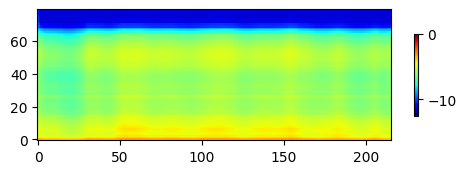

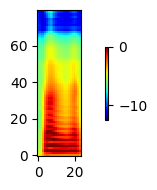

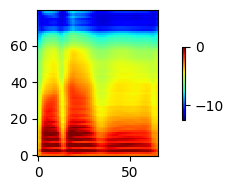

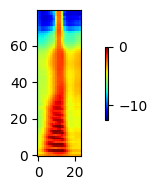

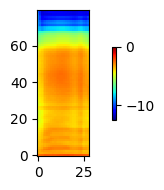

...

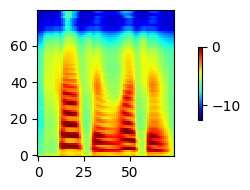

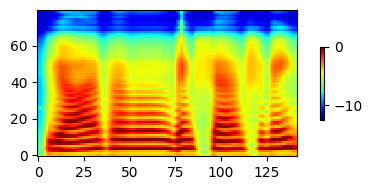

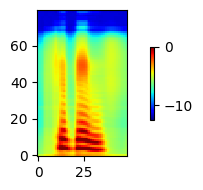

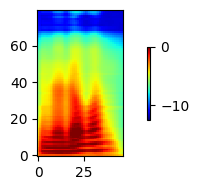

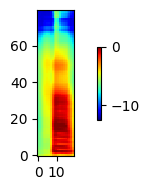

In [75]:
display_topk_closet(0, 20, 'val', val_mcdv6_df)

Top 20 utt with MCD closet to 30. [val set]

UID: 2bf14b91-b7cd-4ccc-b21a-020b2c0aa3c3
###  MCD: 26.086525


(80, 69)
UID: b97e171a-23f7-4c73-94a3-c2fd18d8f340
###  MCD: 25.599823


(80, 35)
UID: 927dcb5d-c33d-42f2-9008-73c355853323
###  MCD: 25.436575


(80, 13)
UID: 3a2dd434-33a0-498c-9947-df56e604dd61
###  MCD: 25.20772


(80, 26)
UID: 4c848686-910e-41bd-b183-9a8867d236a9
###  MCD: 24.893915


(80, 94)
UID: 776ffa84-49ba-4543-ba48-1746de4034d9
###  MCD: 24.329147


(80, 20)
UID: 0348d6d4-d9c1-45d7-bf37-13ca1eef6a9d
###  MCD: 23.16783


(80, 28)
UID: b550d2be-32f0-4d96-9ca6-7a9762cbc095
###  MCD: 22.953695


(80, 15)
UID: 44c60428-6a17-4726-aea0-99506016c30d
###  MCD: 22.552876


(80, 56)
UID: c2690c43-f545-43f2-97c0-83a06475267e
###  MCD: 22.448624


(80, 15)
UID: 537e4cea-fdea-4bfc-a74d-8da344f8269e
###  MCD: 22.444721


(80, 15)
UID: 34525936-5071-45fd-91c2-16018ec8fe07
###  MCD: 22.184296


(80, 72)
UID: 8e2b989d-7499-4d4c-ac60-be9bebda99f7
###  MCD: 22.049515


(80, 14)
UID: 399c3cd4-e12b-46e9-a972-0707cdd14396
###  MCD: 21.872553


(80, 25)
UID: 4e46872f-83a9-4d23-a0b1-41c5478d869b
###  MCD: 21.804544


(80, 14)
UID: 5351051f-493a-4ae3-8873-71cd7be845fa
###  MCD: 21.664812


(80, 33)
UID: 46850873-abef-4490-a582-1a4bac3d4186
###  MCD: 21.641304


(80, 25)
UID: 2667f8d5-30e0-44da-80ce-27df506a8a82
###  MCD: 21.577833


(80, 186)
UID: 0c5205f5-27f1-481a-aad2-00be3eb4e7e2
###  MCD: 21.549402


(80, 22)
UID: c40778c5-b585-4897-94ff-6a35edf19add
###  MCD: 21.359922


(80, 51)


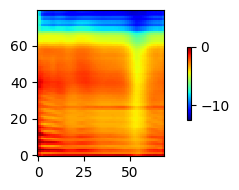

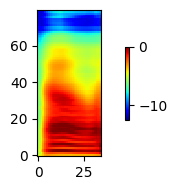

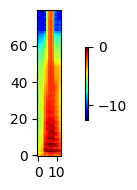

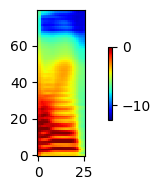

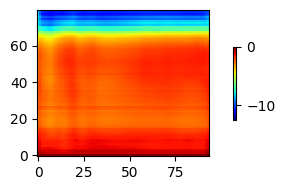

...

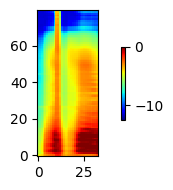

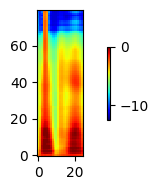

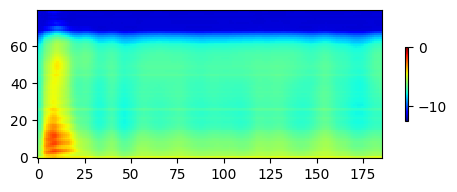

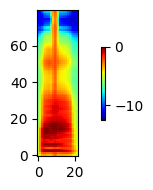

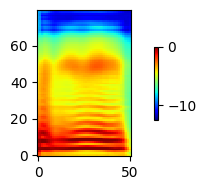

In [76]:
display_topk_closet(30, 20, 'val', val_mcdv6_df)

In [82]:
display_topk_closet_gt(0, 20, 'val', val_mcdv6_df)

Top 20 utt with MCD closet to 0. [val set]

UID: 0fc4a693-2ba5-419b-83cc-51d5e70b75b9
###  MCD: 5.8541403


UID: dcd3a1bc-beb5-49ac-a2c0-833ff646620f
###  MCD: 6.501545


UID: 7f53c386-bf80-47bd-8dbe-295b21eeb289
###  MCD: 6.755201


UID: 3247ffa3-adc8-4978-9be8-4b07a0995e7b
###  MCD: 7.1983185


UID: b8adbe87-2c00-411b-8e12-d769fb3ee849
###  MCD: 7.6513386


UID: 13912c1b-6def-4077-99b5-55016639a40b
###  MCD: 7.7250896


UID: 4332a880-4c45-43dc-be03-bcee2159575b
###  MCD: 7.7614226


UID: 102f7db2-1dde-489d-b4c4-b48feb8a204e
###  MCD: 7.791721


UID: d9fdf898-9154-4817-96eb-fdf449b2ef5a
###  MCD: 7.8354173


UID: ed7af408-b84a-4c02-82a4-85fcab3fc62a
###  MCD: 7.9037185


UID: 373449b0-4444-4d62-9fdb-ec312bf2dbc2
###  MCD: 7.9544897


UID: 96f7f706-db77-47ca-868e-fdc24d8dff7f
###  MCD: 7.9590006


UID: b9cb960d-ab74-435f-bce7-f3c1851b6768
###  MCD: 8.01253


UID: 1b1d0b00-68b8-4259-b569-cc9def32e63c
###  MCD: 8.046775


UID: 310eca6d-46e0-4057-8f7c-d3087a7ba481
###  MCD: 8.075624


UID: fc1e6a1b-9f47-44ea-af9e-f80c1d348147
###  MCD: 8.112765


UID: ae03f670-38f3-433e-a9e1-a36d2e9af9ba
###  MCD: 8.14042


UID: 3bc95a25-5803-4b1b-a66b-6a3f6417bfd5
###  MCD: 8.246139


UID: aa768b16-9a39-42cd-bb0a-11e54dd068bc
###  MCD: 8.265059


UID: e0f9e969-799a-4f86-b052-da1a1cb28310
###  MCD: 8.295284


In [81]:
display_topk_closet_gt(30, 20, 'val', val_mcdv6_df)

Top 20 utt with MCD closet to 30. [val set]

UID: 2bf14b91-b7cd-4ccc-b21a-020b2c0aa3c3
###  MCD: 26.086525


UID: b97e171a-23f7-4c73-94a3-c2fd18d8f340
###  MCD: 25.599823


UID: 927dcb5d-c33d-42f2-9008-73c355853323
###  MCD: 25.436575


UID: 3a2dd434-33a0-498c-9947-df56e604dd61
###  MCD: 25.20772


UID: 4c848686-910e-41bd-b183-9a8867d236a9
###  MCD: 24.893915


UID: 776ffa84-49ba-4543-ba48-1746de4034d9
###  MCD: 24.329147


UID: 0348d6d4-d9c1-45d7-bf37-13ca1eef6a9d
###  MCD: 23.16783


UID: b550d2be-32f0-4d96-9ca6-7a9762cbc095
###  MCD: 22.953695


UID: 44c60428-6a17-4726-aea0-99506016c30d
###  MCD: 22.552876


UID: c2690c43-f545-43f2-97c0-83a06475267e
###  MCD: 22.448624


UID: 537e4cea-fdea-4bfc-a74d-8da344f8269e
###  MCD: 22.444721


UID: 34525936-5071-45fd-91c2-16018ec8fe07
###  MCD: 22.184296


UID: 8e2b989d-7499-4d4c-ac60-be9bebda99f7
###  MCD: 22.049515


UID: 399c3cd4-e12b-46e9-a972-0707cdd14396
###  MCD: 21.872553


UID: 4e46872f-83a9-4d23-a0b1-41c5478d869b
###  MCD: 21.804544


UID: 5351051f-493a-4ae3-8873-71cd7be845fa
###  MCD: 21.664812


UID: 46850873-abef-4490-a582-1a4bac3d4186
###  MCD: 21.641304


UID: 2667f8d5-30e0-44da-80ce-27df506a8a82
###  MCD: 21.577833


UID: 0c5205f5-27f1-481a-aad2-00be3eb4e7e2
###  MCD: 21.549402


UID: c40778c5-b585-4897-94ff-6a35edf19add
###  MCD: 21.359922


In [83]:
display_topk_closet_gt(18, 20, 'val', val_mcdv6_df)

Top 20 utt with MCD closet to 18. [val set]

UID: 6789cd7c-fa96-4a3e-8c65-1247c1babd0f
###  MCD: 18.000761


UID: e72f34b7-2b94-418a-9903-b824166e2017
###  MCD: 17.998682


UID: b193a35b-f2d1-4af9-b0d5-72d6acffe057
###  MCD: 18.004272


UID: 8b62780e-b588-4808-9ba9-eaf3cebaad5b
###  MCD: 18.006151


UID: 91e5c709-9530-4d38-8f4c-5f0915fdd531
###  MCD: 18.021122


UID: e16551b2-1e95-4d47-a7ef-6b1ae7e00236
###  MCD: 17.96611


UID: fc1f5f26-5df5-4c7b-8282-b33cd85fbec6
###  MCD: 18.043303


UID: eede49c0-fc5e-447e-805d-42f70a7baedf
###  MCD: 17.946264


UID: 6404c0bb-bfe9-4c10-a023-4704506f26c9
###  MCD: 18.064844


UID: 536c785d-618f-49a5-a3d0-69be72f4e370
###  MCD: 18.071127


UID: 2084910c-2fd9-4147-9edf-0c5c10966143
###  MCD: 18.082928


UID: 02c7c8ab-45d7-486b-95f7-88ea9a4dbba5
###  MCD: 18.08414


UID: 4956e3aa-90c5-4e2d-a799-314f8ebc2501
###  MCD: 17.9117


UID: 8cc2fa9a-8cf4-4c81-8257-fe3a7ec16bcf
###  MCD: 17.901382


UID: 15f6df99-bc54-453c-bf01-f3f1844af629
###  MCD: 17.88376


UID: 963848d0-f7bb-4316-831d-86403fb6d227
###  MCD: 18.121796


UID: 7212b6a8-d374-45c3-9e5a-103d641e762e
###  MCD: 17.872126


UID: a796f9d5-8783-4c04-b651-c6f21eeaea64
###  MCD: 18.130392


UID: a838a431-7bff-46ee-accf-5e1322594706
###  MCD: 18.13362


UID: 14bcfae4-2138-4627-8c3e-e8c2fa302024
###  MCD: 18.141903


In [84]:
display_topk_closet_gt(18, 20, 'train', train_mcdv6_df)

Top 20 utt with MCD closet to 18. [train set]

UID: bb12f5eb-67d7-4aa0-941b-b9e8f7bba3c4
###  MCD: 16.314287


UID: 55da5227-d472-473a-a38b-a79f56af1448
###  MCD: 15.414665


UID: b3e2c12d-8530-41f7-877b-076dd450e5a1
###  MCD: 15.108876


UID: c6d71379-d3c0-4e5c-b835-87423128767a
###  MCD: 15.070946


UID: 8d687ac9-1b7e-49f0-be0d-f6ca953ae7ea
###  MCD: 14.459346


UID: 7522573e-da09-4c6e-a5fd-0e8eca10051f
###  MCD: 14.19669


UID: 86780c48-07f9-4686-a989-49f649eeb501
###  MCD: 14.0775175


UID: 10e01691-8f81-4628-a48e-368e6dcc35e6
###  MCD: 13.998512


UID: 44d75b69-d1ec-4bb0-bd63-f78bb716d143
###  MCD: 13.647198


UID: 48f13f47-f839-4d6a-a746-7f7b02d13157
###  MCD: 13.574369


UID: 825bf801-ce67-451e-aecc-e60035382616
###  MCD: 13.564831


UID: d5d2ee2b-9e82-489d-a831-50656be826cd
###  MCD: 13.531587


UID: 56b66ee4-0f00-42fa-984e-e7cebfcaa33b
###  MCD: 13.491203


UID: 560d7e44-f955-468e-abb7-cd2688b19614
###  MCD: 13.471592


UID: 564a489c-5cee-4532-8b87-58cd400eecfa
###  MCD: 13.440446


UID: f4f68971-e46d-47b0-8daf-3a4c1f424015
###  MCD: 13.382415


UID: 9e6616ea-0e89-47b4-836b-10aa68d04c19
###  MCD: 13.253289


UID: 7ae29518-2259-4d38-a027-186d5343bad8
###  MCD: 13.220176


UID: fa5983cc-cce5-44a7-8a94-62bb86fa3f38
###  MCD: 13.131105


UID: 4e308d00-6dc5-49e5-abe2-d015130698c6
###  MCD: 13.118002


In [87]:
display_topk_closet_gt(10, 20, 'train', train_mcdv6_df)

Top 20 utt with MCD closet to 10. [train set]

UID: 37120e13-9ca0-4f3a-95fd-a1fbdfb8da3b
###  MCD: 10.00098


UID: 3c53aaab-7001-43da-9d2b-ede372332873
###  MCD: 10.001967


UID: 80ca1c6c-275e-44f9-ac06-8c0ebeb40ced
###  MCD: 9.997572


UID: 371362ea-1fca-44cd-8025-2f4fa11a1262
###  MCD: 10.002635


UID: 0f8fd7b5-1d70-439b-8b4d-2f68c233e3d9
###  MCD: 9.996255


UID: 1b6683fd-132c-42bf-b45d-b09c0865b338
###  MCD: 10.004239


UID: 3286951f-9a3b-4e42-b141-cd34e2f06b84
###  MCD: 10.005054


UID: 1e213cc3-0a0b-4d0e-83f2-c70469c8d2b5
###  MCD: 9.990203


UID: 84a9e453-9bc0-4e9a-a929-3c393d897477
###  MCD: 10.010171


UID: 3db76c53-61c0-4f78-b212-d042929b1163
###  MCD: 9.989621


UID: 258cd08d-310c-4789-bd4c-f1c7dcf88ec4
###  MCD: 9.98959


UID: 6fabcc83-6b82-4bad-bba4-bd318830096b
###  MCD: 10.010799


UID: 09d53312-d8aa-4c18-a03e-d970ac4531e0
###  MCD: 9.989154


UID: 3feeb2e5-553d-4c80-8ac4-8cc46655c4f2
###  MCD: 10.01205


UID: 52db73bb-0be2-4086-b84d-967f8a7c61f0
###  MCD: 10.013581


UID: b7f8a120-4b2c-4bb6-a0fd-773d3d307644
###  MCD: 10.014064


UID: 0632e6fa-de74-4f4b-9794-5ab3e329e92a
###  MCD: 9.985823


UID: 01c623c4-8d04-475e-9056-8aabe219deca
###  MCD: 10.01435


UID: 2d2c9ef6-5944-4807-b9d6-16afdcbc1ddb
###  MCD: 10.014528


UID: a5b58f30-bc3d-402f-8426-5ed7afa65a81
###  MCD: 9.98536


In [88]:
display_topk_closet_gt(8, 20, 'train', train_mcdv6_df)

Top 20 utt with MCD closet to 8. [train set]

UID: 0f6e8f81-635b-487e-87df-cbbab3f4b7cf
###  MCD: 8.000093


UID: 202152f3-8dd8-4b4a-ada6-0885fa37fadc
###  MCD: 7.9998474


UID: 40fc1a30-946e-431d-ab03-7c4e844dd828
###  MCD: 8.000173


UID: 38061601-8097-431a-b597-06f80eb6b366
###  MCD: 7.9997945


UID: cf5229d9-a022-40c6-b6a3-92b1c00ad641
###  MCD: 7.99973


UID: 259bf376-5495-49e0-a8f8-6b08b3b3ae24
###  MCD: 8.000314


UID: 0403e461-87c9-490a-b798-9a278d127660
###  MCD: 7.9996247


UID: 49080b17-47bf-47d7-bf3c-d258d6ee26e1
###  MCD: 7.999594


UID: 28b1e3c2-7efa-4b02-9179-d41887a0656a
###  MCD: 7.99957


UID: b5f82186-9811-474f-b422-d7d0093ba029
###  MCD: 7.9995356


UID: 09c80e59-2332-4acf-ba73-29168cf418d1
###  MCD: 7.9994526


UID: 32d2b5f3-5abf-484e-90c1-e3812d637414
###  MCD: 8.000622


UID: 9413ceba-de44-4c0d-8240-70b45d285a11
###  MCD: 7.9993415


UID: c7a47f10-8faa-4f5b-a65b-15613f1f8df0
###  MCD: 8.000664


UID: 2a39bdb5-fa0c-470d-9bb6-77b3d636d583
###  MCD: 7.999269


UID: 345d994c-14e1-493c-8020-6edc5a7f39ac
###  MCD: 7.9992


UID: 608dbd08-1b07-4d76-9ce3-d2cf2c92199c
###  MCD: 7.999159


UID: 6f10704f-12ed-4d74-9349-5613c685c1c6
###  MCD: 8.000893


UID: eb2a5ba8-8661-4a78-b262-ae777876c9cd
###  MCD: 8.000947


UID: df85cc77-557b-413a-8e98-baf633ca1b24
###  MCD: 8.000982


In [91]:
display_topk_closet_gt_v56(8, 20, 'train', train_mcdv6_df)

Top 20 utt with MCD closet to 8. [train set]

UID: 0f6e8f81-635b-487e-87df-cbbab3f4b7cf
###  MCD: 8.000093


UID: 202152f3-8dd8-4b4a-ada6-0885fa37fadc
###  MCD: 7.9998474


UID: 40fc1a30-946e-431d-ab03-7c4e844dd828
###  MCD: 8.000173


UID: 38061601-8097-431a-b597-06f80eb6b366
###  MCD: 7.9997945


UID: cf5229d9-a022-40c6-b6a3-92b1c00ad641
###  MCD: 7.99973


UID: 259bf376-5495-49e0-a8f8-6b08b3b3ae24
###  MCD: 8.000314


v5 not exist
UID: 0403e461-87c9-490a-b798-9a278d127660
###  MCD: 7.9996247


UID: 49080b17-47bf-47d7-bf3c-d258d6ee26e1
###  MCD: 7.999594


v5 not exist
UID: 28b1e3c2-7efa-4b02-9179-d41887a0656a
###  MCD: 7.99957


UID: b5f82186-9811-474f-b422-d7d0093ba029
###  MCD: 7.9995356


UID: 09c80e59-2332-4acf-ba73-29168cf418d1
###  MCD: 7.9994526


UID: 32d2b5f3-5abf-484e-90c1-e3812d637414
###  MCD: 8.000622


UID: 9413ceba-de44-4c0d-8240-70b45d285a11
###  MCD: 7.9993415


UID: c7a47f10-8faa-4f5b-a65b-15613f1f8df0
###  MCD: 8.000664


UID: 2a39bdb5-fa0c-470d-9bb6-77b3d636d583
###  MCD: 7.999269


UID: 345d994c-14e1-493c-8020-6edc5a7f39ac
###  MCD: 7.9992


UID: 608dbd08-1b07-4d76-9ce3-d2cf2c92199c
###  MCD: 7.999159


UID: 6f10704f-12ed-4d74-9349-5613c685c1c6
###  MCD: 8.000893


UID: eb2a5ba8-8661-4a78-b262-ae777876c9cd
###  MCD: 8.000947


UID: df85cc77-557b-413a-8e98-baf633ca1b24
###  MCD: 8.000982


In [92]:
display_topk_closet_gt_v56(20, 20, 'train', train_mcdv6_df)

Top 20 utt with MCD closet to 20. [train set]

UID: bb12f5eb-67d7-4aa0-941b-b9e8f7bba3c4
###  MCD: 16.314287


UID: 55da5227-d472-473a-a38b-a79f56af1448
###  MCD: 15.414665


UID: b3e2c12d-8530-41f7-877b-076dd450e5a1
###  MCD: 15.108876


UID: c6d71379-d3c0-4e5c-b835-87423128767a
###  MCD: 15.070946


UID: 8d687ac9-1b7e-49f0-be0d-f6ca953ae7ea
###  MCD: 14.459346


UID: 7522573e-da09-4c6e-a5fd-0e8eca10051f
###  MCD: 14.19669


UID: 86780c48-07f9-4686-a989-49f649eeb501
###  MCD: 14.0775175


UID: 10e01691-8f81-4628-a48e-368e6dcc35e6
###  MCD: 13.998512


UID: 44d75b69-d1ec-4bb0-bd63-f78bb716d143
###  MCD: 13.647198


UID: 48f13f47-f839-4d6a-a746-7f7b02d13157
###  MCD: 13.574369


UID: 825bf801-ce67-451e-aecc-e60035382616
###  MCD: 13.564831


UID: d5d2ee2b-9e82-489d-a831-50656be826cd
###  MCD: 13.531587


UID: 56b66ee4-0f00-42fa-984e-e7cebfcaa33b
###  MCD: 13.491203


UID: 560d7e44-f955-468e-abb7-cd2688b19614
###  MCD: 13.471592


UID: 564a489c-5cee-4532-8b87-58cd400eecfa
###  MCD: 13.440446


UID: f4f68971-e46d-47b0-8daf-3a4c1f424015
###  MCD: 13.382415


UID: 9e6616ea-0e89-47b4-836b-10aa68d04c19
###  MCD: 13.253289


UID: 7ae29518-2259-4d38-a027-186d5343bad8
###  MCD: 13.220176


UID: fa5983cc-cce5-44a7-8a94-62bb86fa3f38
###  MCD: 13.131105


UID: 4e308d00-6dc5-49e5-abe2-d015130698c6
###  MCD: 13.118002


In [93]:
display_topk_closet_gt_v56(0, 20, 'train', train_mcdv6_df)

Top 20 utt with MCD closet to 0. [train set]

UID: 435ea1f3-6eff-40a7-93a8-000f4861dc84
###  MCD: 3.5589085


UID: e6d67d17-93c8-4bcf-90ea-26eba9826044
###  MCD: 4.0707154


UID: 860c7982-da84-4be9-8c48-b5325cd60c7b
###  MCD: 4.11017


UID: bcc5cd11-c660-456a-aa17-d9642cf8f800
###  MCD: 4.1233373


UID: 514982f0-0b63-490b-ba77-8ba35a8f7d0c
###  MCD: 4.176795


UID: 8d6c8431-1301-4786-9063-e99c31e256b3
###  MCD: 4.2885303


UID: 3c3a2d20-54b7-4669-8301-cfc7d754a4e3
###  MCD: 4.309416


UID: 22a21ea1-b971-4c97-8079-2af8be344961
###  MCD: 4.3350134


UID: 9353a844-ab02-417e-bf71-cb19b19cbcbc
###  MCD: 4.3403807


UID: 9b987096-048e-4ef0-8167-b22e3e875456
###  MCD: 4.3765693


UID: 8a258433-ec9f-486e-b027-6e6d00fcbe06
###  MCD: 4.391022


UID: f35af4e0-db8e-47aa-8856-0f7a4237d3ab
###  MCD: 4.391073


UID: 4d7f8dd9-f735-42e6-bf06-0640c2d09b79
###  MCD: 4.41525


UID: fb37b447-2e3a-4d8c-a883-592024201bb4
###  MCD: 4.424145


UID: f7b8de42-fa61-477c-a7e3-e3338bcb8137
###  MCD: 4.429368


UID: 2be240ff-1934-451b-bc9a-b8566d8c5ea0
###  MCD: 4.4763885


UID: 26bf591d-76d4-4b5f-a47e-507a7bbfc2e7
###  MCD: 4.4782825


UID: 95b453ef-c4b0-4d6d-a886-4bfc3dd18786
###  MCD: 4.478324


UID: 5df531f7-fd2e-40fd-9e8c-ede1b9cf9ca2
###  MCD: 4.4844956


UID: 122e8065-77ca-4963-a27c-6a463bc3603f
###  MCD: 4.5033493


In [95]:
display_topk_closet_gt_v56(20, 20, 'val', val_mcdv6_df)

Top 20 utt with MCD closet to 20. [val set]

UID: eb15e54a-85a9-41fd-89ba-cf942e5af49f
###  MCD: 20.022505


UID: d04f4330-77cb-4a7a-865f-4b18bfd2a0f1
###  MCD: 20.05533


UID: 25674215-2735-40ef-bddf-c7df563667a4
###  MCD: 19.93253


UID: 62b3c10b-3a34-4fb2-9dcb-60a40eae236e
###  MCD: 19.859825


UID: 1b023c1c-f876-4583-a99e-de5cceeb0de6
###  MCD: 20.192188


UID: d4ad5c01-61e0-49f5-aaaa-a838b1615d59
###  MCD: 20.250067


UID: f53cc355-7eb9-43dd-b343-454839fcb9dd
###  MCD: 19.718771


UID: 711e0889-ef9a-4637-9cf4-1ee49bb2c4fc
###  MCD: 20.30551


UID: 6145cff7-3c4d-4e1f-8ca1-4bb07d1c17de
###  MCD: 20.309568


UID: 2f077263-63d3-4388-9c8d-c2019dacac0b
###  MCD: 20.318926


UID: 3cf61de9-8557-4f90-bdb9-18ac42711342
###  MCD: 19.666868


UID: 3e033b2d-e0e3-4cd1-9238-2a8b9e634359
###  MCD: 19.660494


UID: 16874e86-0b6c-462a-bb5c-9e6b62a04bbd
###  MCD: 20.359518


UID: ac9ce3f0-c35d-4541-bc85-6f3b7edab881
###  MCD: 19.632866


UID: b7a4c964-19c6-4e9d-9dd2-31e35bf18cb0
###  MCD: 19.62393


UID: 8c6849c6-9098-4d0d-83e8-4affb22d6b0f
###  MCD: 19.584242


UID: 6f6c12fb-5efe-4d6a-bc62-014019feb929
###  MCD: 19.575333


UID: 7e324a3e-3d8d-450e-90f5-86c34b52fea5
###  MCD: 19.567427


UID: c1925b96-e358-4126-91f4-9514cced97c5
###  MCD: 20.44013


UID: 0048639e-8a86-4321-a906-f17c2e49742f
###  MCD: 19.545547


In [14]:
train_mcdv6_df[train_mcdv6_df['MCD_recon']<10]['MCD_recon'].describe()

count    26857.000000
mean         7.492335
std          1.027133
min          3.558908
25%          6.773948
50%          7.492991
75%          8.213569
max          9.997572
Name: MCD_recon, dtype: float64

In [13]:
train_mcdv6_df['MCD_recon'].describe()

count    27292.000000
mean         7.545383
std          1.107644
min          3.558908
25%          6.787040
50%          7.513287
75%          8.256839
max         16.314287
Name: MCD_recon, dtype: float64

In [16]:
val_mcdv6_df[val_mcdv6_df['MCD_recon']<16]['MCD_recon'].describe()

count    2483.000000
mean       12.338174
std         1.759287
min         5.854140
25%        11.064789
50%        12.333565
75%        13.626205
max        15.988463
Name: MCD_recon, dtype: float64